NAGA SAI TEJASWI GANDU
========================

## SHORT REPORT
#1. I have created a folder named ‘HAM10000’, which has HAM10000_metadata.csv, and all the images combined from the 2 folders.

#2. In preprocessing step:
- (Above the preprocessing step) I added a cell that constructs a file path string by concatenating the current working directory (os.getcwd()), the directory named "HAM10000/", and the directory named "test/": os.getcwd() + "/HAM10000/"+ "test/"

- In os.makedirs function call, I added an argument exist_ok=True, just so function will not raise an error if the directory already exists.

- I replaced ‘sample = metadata[metadata['dx'] == i]['image_id'][:5]’ with ‘sample = metadata[metadata['dx'] == i]['image_id']’

- I replaced 'shutil.copyfile' with 'shutil.move' to remove the image files that are no longer needed.

#3. In Median Frequency Balancing: I replaced ‘counts = counts.astype(np.float)’ with ‘counts = counts.astype(float)’

#4. In Data Augmentation step, I replaced ‘data_dir = "/data/HAM10000"’ with ‘data_dir = "HAM10000/test"’ because that’s the path of the 7 cell type folders.

#5. In Train, Test, and Validation Split: In __init__ function definition, I replaced ‘def __init__(self, class_vector)’ with ‘def __init__(self, class_vector, test_size)’ because the StratifiedSampler function call has 2 arguments.

#6. In section where we display some training images, I replaced ‘images, labels = dataiter.next()’ with ‘images, labels = next(dataiter)’ because of syntax error.

#7. I didn’t find any errors in ResNet part until the Test part where I got the same syntax error for dataiter.next(), which I changed to next(dataiter)

#8. In Gradcam section, I changed ‘from collections import OrderedDict, Sequence’ to 
‘from collections import OrderedDict
from collections.abc import Sequence’

Skin Cancer Classification - An Educational Guide
=====================
In this tutorial we aim to provide a simple step-by-step guide to anyone who wants to work on the problem of skin lesion classification regardless of their level or expertise; from medical doctors, to master students and more experienced researchers.

## Using this guide you will learn:

- How to load the data, visualise it and uncover more about the class distribution and meta-data.
- How to utilise architectures with varying complexity from a few convolutional layers to hundreds of them.
- How to train a model with appropriate optimisers and loss functions.
- How to rigorously test your trained model, providing not only metrics such as accuracy but also visualisations like confusion matrix and Grad — Cam.
- How to analyse and understand your results.

To conclude with, we will provide a few more tips that are usually utilised by the participants of the ISIC Challenges, that will help you increase your model’s performance even more so that you can beat our performance and explore more advanced training schemes.


What about data?
----------------

The HAM10000 ("Human Against Machine with 10000 training images") dataset which contains 10,015 dermatoscopic images was made publically available by the Harvard database on June 2018 in the hopes to provide training data for automating the process of skin cancer lesion classifications. The motivation behind this act was to provide the public with an abundance and variability of data source for machine learning training purposes such that the results may be compared with that of human experts. If successful, the appplications would bring cost and time saving regimes to hospitals and medical professions alike.

Apart from the 10,015 images, a metadata file with demographic information of each lesion is provided as well. More than 50% of lesions are confirmed through histopathology (histo), the ground truth for the rest of the cases is either follow-up examination (follow_up), expert consensus (consensus), or confirmation by in-vivo confocal microscopy (confocal)

You can download the dataset here: https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/DBW86T

The 7 classes of skin cancer lesions included in this dataset are:

1. Melanocytic nevi
2. Melanoma
3. Benign keratosis-like lesions
4. Basal cell carcinoma
5. Actinic keratoses
6. Vascular lesions
7. Dermatofibroma


In [1]:
!pip install imageio
!pip install scikit-image
!pip install seaborn
!pip install torch
!pip install torch torchvision
!pip install numpy pandas scikit-learn scipy imageio scikit-image seaborn
!pip install Pillow matplotlib
!pip install numpy pandas scikit-learn scipy scikit-image imageio seaborn pillow matplotlib

  Obtaining dependency information for imageio from https://files.pythonhosted.org/packages/02/25/66533a8390e3763cf8254dee143dbf8a830391ea60d2762512ba7f9ddfbe/imageio-2.34.0-py3-none-any.whl.metadata
  Obtaining dependency information for numpy from https://files.pythonhosted.org/packages/0f/50/de23fde84e45f5c4fda2488c759b69990fd4512387a8632860f3ac9cd225/numpy-1.26.4-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 529.1 kB/s eta 0:00:00 0:00:01
  Obtaining dependency information for pillow>=8.3.2 from https://files.pythonhosted.org/packages/5c/c6/5b6b1f7362267494a423b45af684d604491565e81436e3ebeefee68f78fd/pillow-10.2.0-cp312-cp312-manylinux_2_28_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 313.4/313.4 kB 2.5 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 16.6 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 13.3 MB/s eta 0:00:00

In [5]:
import torch
from torch import nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import numpy as np
import os

import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_fscore_support
import scipy.ndimage
from scipy import misc
from glob import glob
from scipy import stats
from sklearn.preprocessing import LabelEncoder, StandardScaler
import skimage
import imageio
import seaborn as sns
from PIL import Image
import glob
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=1)

#### Let's analyze the metadata of the dataset

In [7]:
# importing metadata and checking for its shape
data_dir = "HAM10000"

metadata = pd.read_csv(data_dir + '/HAM10000_metadata.csv') # Reading the metadata file into a DataFrame
print(metadata.shape) # Printing the shape of the metadata DataFrame

# label encoding the seven classes for skin cancers
le = LabelEncoder() # Initializing a LabelEncoder object
le.fit(metadata['dx']) # Fitting the LabelEncoder to the 'dx' column in the metadata DataFrame
LabelEncoder()
print("Classes:", list(le.classes_)) # Printing the unique classes in the 'dx' column

metadata['label'] = le.transform(metadata["dx"]) # Transforming the 'dx' column values into numerical labels and storing them in a new 'label' column
metadata.sample(10) # Displaying a random sample of 10 rows from the metadata DataFrame

(10015, 8)
Classes: ['akiec', 'bcc', 'bkl', 'df', 'mel', 'nv', 'vasc']


,lesion_id,image_id,dx,dx_type,age,sex,localization,dataset,label
3262,HAM_0000327,ISIC_0026682,nv,follow_up,50.0,female,trunk,vidir_molemax,5
3315,HAM_0000529,ISIC_0030540,nv,follow_up,45.0,female,upper extremity,vidir_molemax,5
1020,HAM_0005291,ISIC_0026907,bkl,consensus,55.0,male,back,vidir_molemax,2
7062,HAM_0006822,ISIC_0030350,nv,histo,30.0,female,lower extremity,vidir_modern,5
2773,HAM_0005984,ISIC_0026117,bcc,histo,75.0,female,face,rosendahl,1
3896,HAM_0007434,ISIC_0024816,nv,follow_up,65.0,female,back,vidir_molemax,5
7733,HAM_0002208,ISIC_0034029,nv,histo,20.0,female,lower extremity,vidir_modern,5
9507,HAM_0001613,ISIC_0033542,nv,consensus,65.0,male,abdomen,vidir_modern,5
1282,HAM_0006253,ISIC_0030171,mel,histo,65.0,male,back,vidir_modern,4
5262,HAM_0003769,ISIC_0027692,nv,follow_up,50.0,female,trunk,vidir_molemax,5


/tmp/ipykernel_2840987/3736076089.py:27: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(sample_age['age'], fit=stats.norm, color='red') # Plotting a distribution plot for the 'age' column with a normal curve


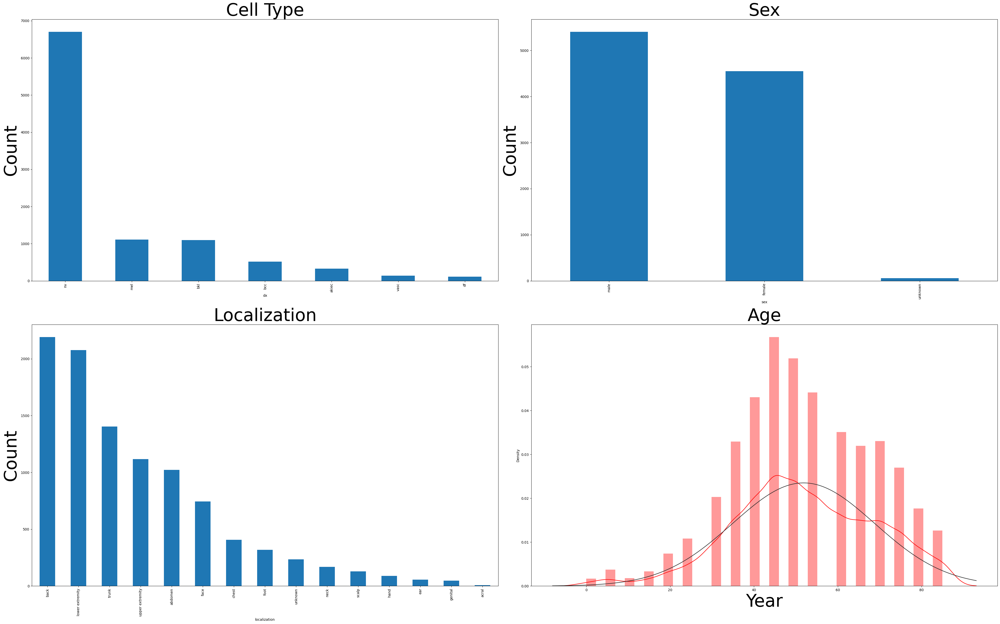

In [8]:
# Getting a sense of what the distribution of each column looks like

# Create a new figure with a large size
fig = plt.figure(figsize=(40,25))

# Create subplot 1 for 'Cell Type' column
ax1 = fig.add_subplot(221)
metadata['dx'].value_counts().plot(kind='bar', ax=ax1) # Plotting a bar chart of the counts of each unique value in the 'dx' column
ax1.set_ylabel('Count', size=50) # Setting the y-axis label
ax1.set_title('Cell Type', size=50) # Setting the title for the subplot

# Create subplot 2 for 'Sex' column
ax2 = fig.add_subplot(222)
metadata['sex'].value_counts().plot(kind='bar', ax=ax2) # Plotting a bar chart of the counts of each unique value in the 'sex' column
ax2.set_ylabel('Count', size=50) # Setting the y-axis label
ax2.set_title('Sex', size=50) # Setting the title for the subplot

# Create subplot 3 for 'Localization' column
ax3 = fig.add_subplot(223)
metadata['localization'].value_counts().plot(kind='bar', ax=ax3) # Plotting a bar chart of the counts of each unique value in the 'localization' column
ax3.set_ylabel('Count', size=50) # Setting the y-axis label
ax3.set_title('Localization', size=50) # Setting the title for the subplot

# Create subplot 4 for 'Age' column
ax4 = fig.add_subplot(224)
sample_age = metadata[pd.notnull(metadata['age'])] # Filtering out rows where 'age' column is not null
sns.distplot(sample_age['age'], fit=stats.norm, color='red') # Plotting a distribution plot for the 'age' column with a normal curve
ax4.set_title('Age', size=50) # Setting the title for the subplot
ax4.set_xlabel('Year', size=50) # Setting the x-axis label

# Adjust the layout of the subplots and display the figure
plt.tight_layout()
plt.show()

As you can see there is imbalance in the number of images per class. There  are much more images for the lesion type "Melanocytic Nevi" compared to other types. This is an usual occurence for medical datasets and so it is very important to analyze the data from beforehand.

#### Pre-processing the dataset
Before we load the data we need to alter the dataset structure.
When you download the dataset, all the images are together in a folder. To use Pytorch dataloader we need to seggregrate the images into folders of their respetive labels. You can use the following script to automate the process.

In [9]:
os.getcwd() + "/HAM10000/"+ "test/" 
#I added a cell that constructs a file path string by concatenating the current working directory (os.getcwd()), the directory named "HAM10000/HAM10000", and the directory named "test/": os.getcwd() + "/HAM10000/HAM10000"+ "test/"

'/usr/cs/grad/master/ngandu/CHM/HW4/HAM10000/test/'

In [10]:
import os  # Importing the os module for interacting with the operating system
import shutil  # Importing the shutil module for file operations
# Setting the data directory to the current working directory + "/HAM10000/HAM10000"
data_dir = os.getcwd() + "/HAM10000/"
# Setting the destination directory to the data directory + "test/"
dest_dir = data_dir + "test/"
metadata = pd.read_csv(data_dir + '/HAM10000_metadata.csv')  # Reading the metadata file into a DataFrame

label = ['bkl', 'nv', 'df', 'mel', 'vasc', 'bcc', 'akiec']  # Defining a list of labels for different skin conditions
label_images = []  # Initializing an empty list to store image IDs for each label

# Iterating through each label in the list
for i in label:
    os.makedirs(dest_dir + str(i) + "/", exist_ok=True)  # Creating a directory for the current label in the destination directory if it doesn't exist
    sample = metadata[metadata['dx'] == i]['image_id']  # Filtering the metadata for image IDs corresponding to the current label
    label_images.extend(sample)  # Extending the label_images list with the image IDs for the current label
    # Iterating through each image ID for the current label
    for id in label_images:
        # Moving the image file from the data directory to the corresponding label directory in the destination directory
        shutil.move((data_dir + "/" + id + ".jpg"), (dest_dir + i + "/" + id + ".jpg"))
    label_images = []  # Clearing the label_images list for the next label

#### Let's visualize some examples

/tmp/ipykernel_2840987/3005183991.py:17: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  im_sample = imageio.imread(im_sample) # Reading the image file using imageio


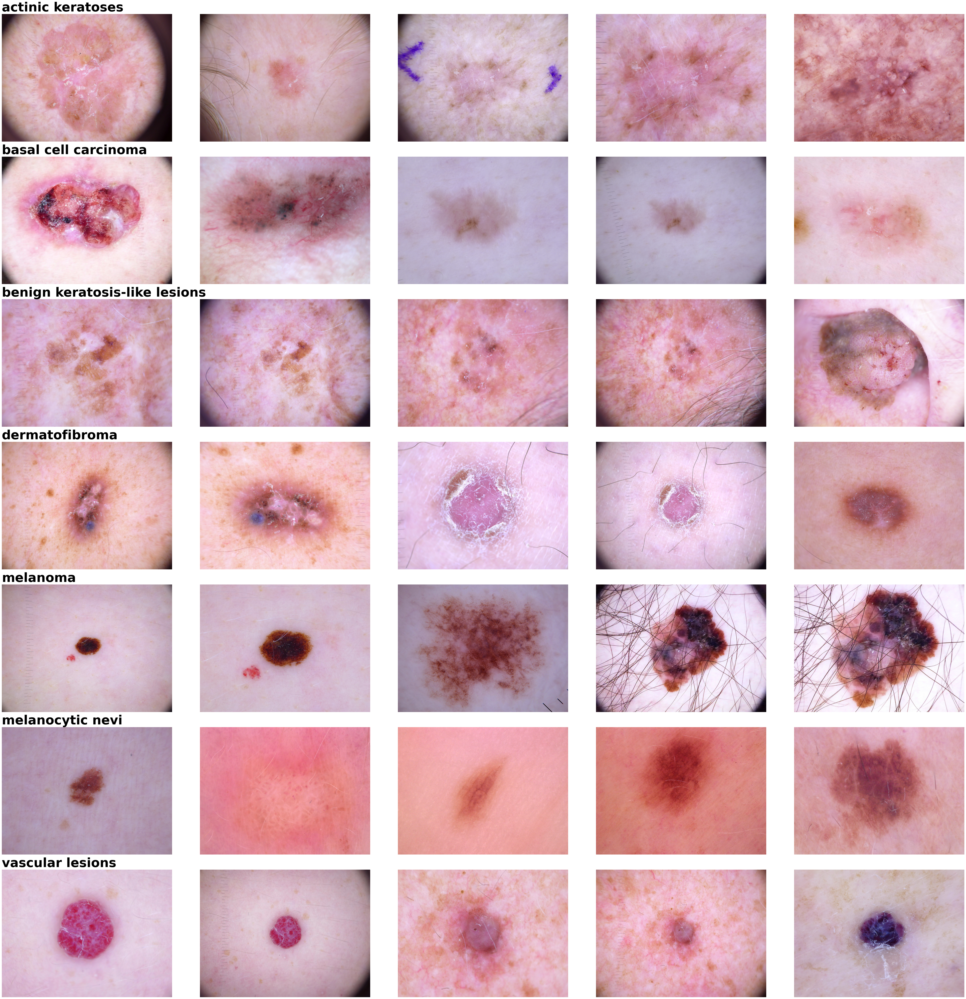

In [11]:
label = ['akiec', 'bcc', 'bkl', 'df', 'mel', 'nv', 'vasc'] # List of labels for different skin conditions
label_images = [] # Initializing an empty list to store image IDs
classes = ['actinic keratoses', 'basal cell carcinoma', 'benign keratosis-like lesions', 'dermatofibroma', 'melanoma', 'melanocytic nevi', 'vascular lesions'] # List of classes corresponding to each label

fig = plt.figure(figsize=(55, 55)) # Creating a new figure with a large size
k = range(7) # Creating a range object for 7 elements

# Iterating through each label in the list
for i in label:
    sample = metadata[metadata['dx'] == i]['image_id'][:5] # Extracting the first 5 image IDs for each label
    label_images.extend(sample) # Adding the image IDs to the label_images list

# Iterating through each position and image ID in the label_images list
for position, ID in enumerate(label_images):
    labl = metadata[metadata['image_id'] == ID]['dx'] # Getting the label for the current image ID
    im_sample = data_dir + "/test/" + labl.values[0] + f'/{ID}.jpg' # Constructing the path to the image file
    im_sample = imageio.imread(im_sample) # Reading the image file using imageio

    plt.subplot(7, 5, position+1) # Creating a subplot for each image
    plt.imshow(im_sample) # Displaying the image
    plt.axis('off') # Turning off the axis for the plot

    if position % 5 == 0: # Adding title for each class
        title = int(position/5)
        plt.title(classes[title], loc='left', size=50, weight="bold")

plt.tight_layout() # Adjusting the layout of the subplots
plt.show() # Displaying the plot

#### Median Frequency Balancing
As we saw above that there is class imbalance in our dataset. To solve that we use this method.

In [12]:
#print(metadata['dx'].value_counts())
#print(metadata[metadata['dx']=='nv']['dx'].value_counts())
label = ['akiec', 'bcc', 'bkl', 'df', 'mel', 'nv', 'vasc'] # List of labels

def estimate_weights_mfb(label):
    class_weights = np.zeros_like(label, dtype=float) # Initializing an array to store class weights
    counts = np.zeros_like(label) # Initializing an array to store counts for each label
    # Iterating through each index and label in the label list
    for i, l in enumerate(label):
        counts[i] = metadata[metadata['dx'] == str(l)]['dx'].value_counts()[0] # Counting the occurrences of each label in the metadata
    counts = counts.astype(float) # Converting counts to float
    #print(counts)
    median_freq = np.median(counts) # Calculating the median frequency of label occurrences
    #print(median_freq)
    #print(weights.shape)
    # Iterating through each index and label in the label list
    for i, label in enumerate(label):
        #print(label)
        class_weights[i] = median_freq / counts[i] # Calculating the class weight for each label
    return class_weights

classweight = estimate_weights_mfb(label) # Calculating class weights for the given labels

for i in range(len(label)):
    print(label[i], ":", classweight[i]) # Printing each label and its corresponding class weight


akiec : 1.5718654434250765
bcc : 1.0
bkl : 0.467697907188353
df : 4.469565217391304
mel : 0.4618149146451033
nv : 0.07665920954511558
vasc : 3.619718309859155


/tmp/ipykernel_2840987/623777431.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  counts[i] = metadata[metadata['dx'] == str(l)]['dx'].value_counts()[0] # Counting the occurrences of each label in the metadata
/tmp/ipykernel_2840987/623777431.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  counts[i] = metadata[metadata['dx'] == str(l)]['dx'].value_counts()[0] # Counting the occurrences of each label in the metadata
/tmp/ipykernel_2840987/623777431.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent w

#### Data Augmentation
It is a common fact that medical data is scarce. But to learn a very good model, the network needs a lot of data. So to tackle the problem we perform data augmentation.

First we normalize the images. Data normalization is an important step which ensures that each input parameter (pixel, in this case) has a similar data distribution. This makes convergence faster while training the network. Data normalization is done by subtracting the mean from each pixel and then dividing the result by the standard deviation. The distribution of such data would resemble a Gaussian curve centered at zero.
Since, skin lesion images are natural images, we use the normalization values (mean and standard deviation) of Imagenet dataset.

We also perform data augmentation:
- Flipping the image horizontally: *RandomHorizontalFlip()*
- Rotating image 60 degrees: *RandomRotation()* . 60 degrees is chosen as best practice. You can experiment with other angles.

The augmentation is applied using the *transform.Compose()* function of Pytorch.
Take note, we only augment the training set. This is because, augmentation is done to aid the training process. So there is no point in augmenting the test set.

In [13]:
data_dir = "HAM10000/test" # Setting the data directory to "HAM10000/test"

# normalization values for pretrained resnet on Imagenet
norm_mean = (0.4914, 0.4822, 0.4465) # Mean values for normalization
norm_std = (0.2023, 0.1994, 0.2010) # Standard deviation values for normalization

batch_size = 50 # Setting the batch size for training
validation_batch_size = 10 # Setting the batch size for validation
test_batch_size = 10 # Setting the batch size for testing

# We compute the weights of individual classes and convert them to tensors
class_weights = estimate_weights_mfb(label) # Calculating class weights for the given labels
class_weights = torch.FloatTensor(class_weights) # Converting class weights to a tensor

transform_train = transforms.Compose([ # Defining a composition of image transformations for training
              transforms.Resize((224,224)), # Resizing the image to 224x224
              transforms.RandomHorizontalFlip(), # Randomly flipping the image horizontally
              transforms.RandomRotation(degrees=60), # Randomly rotating the image by 60 degrees
              transforms.ToTensor(), # Converting the image to a tensor
              transforms.Normalize(norm_mean, norm_std), # Normalizing the image using mean and standard deviation
              ])

transform_test = transforms.Compose([ # Defining a composition of image transformations for testing
                    transforms.Resize((224,224)), # Resizing the image to 224x224
                    transforms.ToTensor(), # Converting the image to a tensor
                    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)), # Normalizing the image using mean and standard deviation
                    ])

/tmp/ipykernel_2840987/623777431.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  counts[i] = metadata[metadata['dx'] == str(l)]['dx'].value_counts()[0] # Counting the occurrences of each label in the metadata
/tmp/ipykernel_2840987/623777431.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  counts[i] = metadata[metadata['dx'] == str(l)]['dx'].value_counts()[0] # Counting the occurrences of each label in the metadata
/tmp/ipykernel_2840987/623777431.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent w

## Train, Test and Validation Split

We split the entire dataset into 3 parts:
- Train: 80%
- Test: 20%
- Validation: 20%

The splitting is done class wise so that we have equal representation of all classes in each subset of the data.

In [14]:
# Importing necessary libraries
import torch as th
import math

# Define test and validation size
test_size = 0.2
val_size = 0.2

# Define base class for all Samplers
class Sampler(object):
    """Base class for all Samplers.
    """
    
    # Constructor
    def __init__(self, data_source):
        pass

    # Iterator method (to iterate through the sampler)
    def __iter__(self):
        raise NotImplementedError

    # Length method (to get the length of the sampler)
    def __len__(self):
        raise NotImplementedError

# Define StratifiedSampler class which inherits from Sampler
class StratifiedSampler(Sampler):
    """Stratified Sampling
    Provides equal representation of target classes
    """
    
    # Constructor
    def __init__(self, class_vector, test_size):
        """
        Arguments
        ---------
        class_vector : torch tensor
            a vector of class labels
        test_size : float
            proportion of the dataset to include in the test split
        """
        self.n_splits = 1
        self.class_vector = class_vector
        self.test_size = test_size

    # Method to generate sample array using StratifiedShuffleSplit
    def gen_sample_array(self):
        try:
            from sklearn.model_selection import StratifiedShuffleSplit
        except:
            print('Need scikit-learn for this functionality')
        import numpy as np
        
        # Creating StratifiedShuffleSplit object
        s = StratifiedShuffleSplit(n_splits=self.n_splits, test_size=self.test_size)
        
        # Generating random data and labels
        X = th.randn(self.class_vector.size(0), 2).numpy()
        y = self.class_vector.numpy()
        
        # Getting the splits
        s.get_n_splits(X, y)

        # Getting train and test indices
        train_index, test_index= next(s.split(X, y))
        return train_index, test_index

    # Iterator method
    def __iter__(self):
        return iter(self.gen_sample_array())

    # Length method
    def __len__(self):
        return len(self.class_vector)

# Assuming `data_dir` is defined elsewhere in the code
dataset = torchvision.datasets.ImageFolder(root=data_dir)

# Get labels for each sample in the dataset
data_label = [s[1] for s in dataset.samples]

# Create StratifiedSampler for the entire dataset
ss = StratifiedSampler(torch.FloatTensor(data_label), test_size)

# Generate train and test indices for the entire dataset
pre_train_indices, test_indices = ss.gen_sample_array()

# The "pre" is necessary to use array to identify train/ val indices with indices generated by second sampler

# Remove test samples from train samples
train_label = np.delete(data_label, test_indices, None)

# Create StratifiedSampler for the train dataset (excluding test samples)
ss = StratifiedSampler(torch.FloatTensor(train_label), test_size)

# Generate train and validation indices for the train dataset
train_indices, val_indices = ss.gen_sample_array()

# Prepare indices dictionary for train, validation, and test splits
indices = {
    'train': pre_train_indices[train_indices],  # Indices of second sampler are used on pre_train_indices
    'val': pre_train_indices[val_indices],      # Indices of second sampler are used on pre_train_indices
    'test': test_indices
}

# Extract train, validation, and test indices from the indices dictionary
train_indices = indices['train']
val_indices = indices['val']
test_indices = indices['test']

# Print the sizes of train, validation, and test datasets
print("Train Data Size:", len(train_indices))
print("Test Data Size:", len(test_indices))
print("Validation Data Size:", len(val_indices))


Train Data Size: 6409
Test Data Size: 2003
Validation Data Size: 1603


Now we use Pytorch data loader to load the dataset into the memory.

In [15]:
SubsetRandomSampler = torch.utils.data.sampler.SubsetRandomSampler # Assigning the SubsetRandomSampler class from torch.utils.data.sampler to the variable SubsetRandomSampler

dataset = torchvision.datasets.ImageFolder(root=data_dir, transform=transform_train) # Loading the image dataset from the specified root directory with the specified transformation for training

train_samples = SubsetRandomSampler(train_indices) # Creating a SubsetRandomSampler for the training indices
val_samples = SubsetRandomSampler(val_indices) # Creating a SubsetRandomSampler for the validation indices
test_samples = SubsetRandomSampler(test_indices) # Creating a SubsetRandomSampler for the test indices

train_data_loader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=1, sampler=train_samples) # Creating a data loader for the training dataset with the specified batch size, no shuffling, 1 worker, and using the train_samples as the sampler
validation_data_loader = torch.utils.data.DataLoader(dataset, batch_size=validation_batch_size, shuffle=False, sampler=val_samples) # Creating a data loader for the validation dataset with the specified batch size, no shuffling, and using the val_samples as the sampler

dataset = torchvision.datasets.ImageFolder(root=data_dir, transform=transform_test) # Loading the image dataset from the specified root directory with the specified transformation for testing
test_data_loader = torch.utils.data.DataLoader(dataset, batch_size=test_batch_size, shuffle=False, sampler=test_samples) # Creating a data loader for the test dataset with the specified batch size, no shuffling, and using the test_samples as the sampler

Let us see some of the training images.



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


melanocytic nevi,  melanocytic nevi,  melanoma,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  melanoma,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  actinic keratoses,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  actinic keratoses,  benign keratosis-like lesions,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi,  melanoma,  melanocytic nevi,  vascular lesions, 


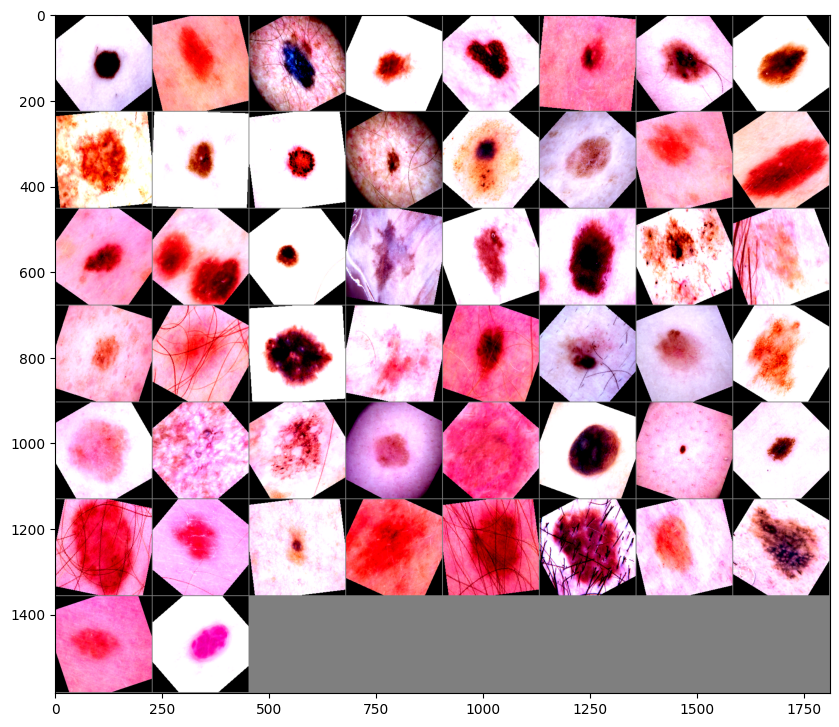

In [16]:
fig = plt.figure(figsize=(10, 15)) # Creating a new figure for plotting with the specified size

def imshow(img):
    img = img / 2 + 0.5 # Denormalizing the image data by scaling and shifting the values
    npimg = img.numpy() # Converting the image data to a NumPy array
    plt.imshow(np.transpose(npimg, (1, 2, 0))) # Displaying the image with the specified transposition

dataiter = iter(train_data_loader) # Creating an iterator for the training data loader
images, labels = next(dataiter) # Getting the next batch of images and their corresponding labels from the iterator

imshow(torchvision.utils.make_grid(images)) # Displaying the images as a grid using the defined imshow function
print(' '.join('%5s, ' % classes[labels[j]] for j in range(len(labels)))) # Printing the labels corresponding to the displayed images

# Switching to superior network architecture:Resnet18

In [17]:
from torch import nn # Importing the nn module from the torch library

num_classes = len(classes) # Calculating the number of classes from the length of the 'classes' variable
net = torchvision.models.resnet18(pretrained=True) # Loading the pre-trained ResNet-18 model from torchvision models

net.fc = nn.Linear(512, num_classes) # Replacing the last fully connected layer (fc) of the ResNet-18 model with a new linear layer with the number of output features matching the number of classes
net = net.to(device) # Moving the model to the specified device (e.g., GPU if available)

/usr/cs/grad/master/ngandu/myenv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/cs/grad/master/ngandu/myenv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


3. Define a Loss function and Optimizer

Let's use a Classification Cross-Entropy loss.

$H_{y'} (y) := - \sum_{i} y_{i}' \log (y_i)$



The most common and effective Optimizer currently used is **Adam: Adaptive Moments**. You can look [here](https://arxiv.org/abs/1412.6980) for more information.


In [18]:
import torch.optim as optim # Importing the optim module from torch for optimization algorithms

class_weights = class_weights.to(device) # Moving the class weights to the specified device
criterion = nn.CrossEntropyLoss(weight=class_weights) # Defining the Cross Entropy Loss function with the specified class weights
optimizer = optim.Adam(net.parameters(), lr=1e-5) # Using the Adam optimizer to optimize the parameters of the neural network with a learning rate of 1e-5
print(net) # Printing the neural network architecture

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

These are some helper functions to evaluate the training process.

In [26]:
device = torch.device('cuda:1')
device

device(type='cuda', index=1)

In [27]:
! nvidia-smi

2058.60s - pydevd: Sending message related to process being replaced timed-out after 5 seconds
Tue Mar 26 00:41:14 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.161.07             Driver Version: 535.161.07   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA RTX 6000 Ada Gene...    On  | 00000000:4F:00.0 Off |                  Off |
| 30%   39C    P2              82W / 300W |   8057MiB / 49140MiB |      5%      Default |
|                                         |                    

In [28]:
from sklearn.metrics import accuracy_score # Importing the accuracy_score function from sklearn.metrics for calculating the accuracy of the model

def get_accuracy(predicted, labels):
    batch_len = 0 # Initializing the batch length to 0
    correct = 0 # Initializing the number of correct predictions to 0
    batch_len = labels.size(0) # Getting the length of the batch from the labels
    correct = (predicted == labels).sum().item() # Calculating the number of correct predictions by comparing the predicted labels with the true labels
    return batch_len, correct # Returning the batch length and the number of correct predictions

def evaluate(model, val_loader):
    losses = 0 # Initializing the total loss to 0
    num_samples_total = 0 # Initializing the total number of samples to 0
    correct_total = 0 # Initializing the total number of correct predictions to 0
    model.eval() # Setting the model to evaluation mode
    for inputs, labels in val_loader: # Iterating over the validation data loader
        inputs, labels = inputs.to(device), labels.to(device) # Moving the inputs and labels to the specified device
        out = model(inputs) # Passing the inputs through the model to get the output
        _, predicted = torch.max(out, 1) # Getting the predicted class labels from the output
        loss = criterion(out, labels) # Calculating the loss using the criterion (cross entropy loss)
        losses += loss.item() # Adding the loss to the total loss
        b_len, corr = get_accuracy(predicted, labels) # Getting the batch length and the number of correct predictions
        num_samples_total += b_len # Adding the batch length to the total number of samples
        correct_total += corr # Adding the number of correct predictions to the total number of correct predictions
    accuracy = correct_total / num_samples_total # Calculating the overall accuracy by dividing the total number of correct predictions by the total number of samples
    losses = losses / len(val_loader) # Calculating the average loss by dividing the total loss by the number of batches in the validation data loader
    return losses, accuracy # Returning the average loss and the overall accuracy

## Train the network


This is when things start to get interesting.
We simply loop over the training data iterator, and feed the inputs to the
network and optimize.



In [32]:
# number of loops over the dataset
num_epochs = 50 # Setting the number of epochs to 50
accuracy = [] # Initializing an empty list to store the training accuracy for each epoch
val_accuracy = [] # Initializing an empty list to store the validation accuracy for each epoch
losses = [] # Initializing an empty list to store the training loss for each epoch
val_losses = [] # Initializing an empty list to store the validation loss for each epoch

for epoch in range(num_epochs): # Iterating over the specified number of epochs
    running_loss = 0.0 # Initializing the running loss to 0.0
    correct_total = 0.0 # Initializing the total number of correct predictions to 0.0
    num_samples_total = 0.0 # Initializing the total number of samples to 0.0
    
    for i, data in enumerate(train_data_loader): # Iterating over the training data loader
        # get the inputs
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device) # Moving the inputs and labels to the specified device
        
        # set the parameter gradients to zero
        optimizer.zero_grad() # Zeroing the gradients of the model parameters
        
        # forward + backward + optimize
        outputs = net(inputs) # Passing the inputs through the neural network model to get the outputs
        loss = criterion(outputs, labels) # Calculating the loss using the criterion (cross entropy loss)
        loss.backward() # Performs a backward pass through the model to compute gradients
        optimizer.step() # Updating the model parameters using the computed gradients
        
        # compute accuracy
        _, predicted = torch.max(outputs, 1) # Getting the predicted class labels from the outputs
        b_len, corr = get_accuracy(predicted, labels) # Getting the batch length and the number of correct predictions
        num_samples_total += b_len # Adding the batch length to the total number of samples
        correct_total += corr # Adding the number of correct predictions to the total number of correct predictions
        
        running_loss += loss.item() # Adding the loss to the running loss
    
    running_loss /= len(train_data_loader) # Calculating the average loss by dividing the running loss by the number of batches in the training data loader
    train_accuracy = correct_total / num_samples_total # Calculating the training accuracy by dividing the total number of correct predictions by the total number of samples
    
    val_loss, val_acc = evaluate(net, validation_data_loader) # Calculating the validation loss and accuracy using the evaluate function
    
    print('Epoch: %d' % (epoch+1)) # Printing the current epoch number
    print('Loss: %.3f Accuracy:%.3f' % (running_loss, train_accuracy)) # Printing the training loss and accuracy
    print('Validation Loss: %.3f Val Accuracy: %.3f' % (val_loss, val_acc)) # Printing the validation loss and accuracy
    
    losses.append(running_loss) # Appending the training loss to the list of losses
    val_losses.append(val_loss) # Appending the validation loss to the list of validation losses
    accuracy.append(train_accuracy) # Appending the training accuracy to the list of accuracies
    val_accuracy.append(val_acc) # Appending the validation accuracy to the list of validation accuracies

print('Finished Training') # Printing a message indicating that training has finished

Epoch: 1
Loss: 1.008 Accuracy:0.650
Validation Loss: 0.949 Val Accuracy: 0.666
Epoch: 2
Loss: 0.849 Accuracy:0.681
Validation Loss: 0.898 Val Accuracy: 0.700
Epoch: 3
Loss: 0.766 Accuracy:0.704
Validation Loss: 0.861 Val Accuracy: 0.691
Epoch: 4
Loss: 0.710 Accuracy:0.720
Validation Loss: 0.818 Val Accuracy: 0.723
Epoch: 5
Loss: 0.649 Accuracy:0.731
Validation Loss: 0.907 Val Accuracy: 0.761
Epoch: 6
Loss: 0.609 Accuracy:0.748
Validation Loss: 0.825 Val Accuracy: 0.731
Epoch: 7
Loss: 0.559 Accuracy:0.751
Validation Loss: 0.799 Val Accuracy: 0.766
Epoch: 8
Loss: 0.538 Accuracy:0.767
Validation Loss: 0.783 Val Accuracy: 0.766
Epoch: 9
Loss: 0.497 Accuracy:0.768
Validation Loss: 0.843 Val Accuracy: 0.695
Epoch: 10
Loss: 0.481 Accuracy:0.774
Validation Loss: 0.758 Val Accuracy: 0.759
Epoch: 11
Loss: 0.464 Accuracy:0.783
Validation Loss: 0.769 Val Accuracy: 0.730
Epoch: 12
Loss: 0.417 Accuracy:0.796
Validation Loss: 0.814 Val Accuracy: 0.753
Epoch: 13
Loss: 0.405 Accuracy:0.799
Validation L

#### Plot the training  and validation loss curves.

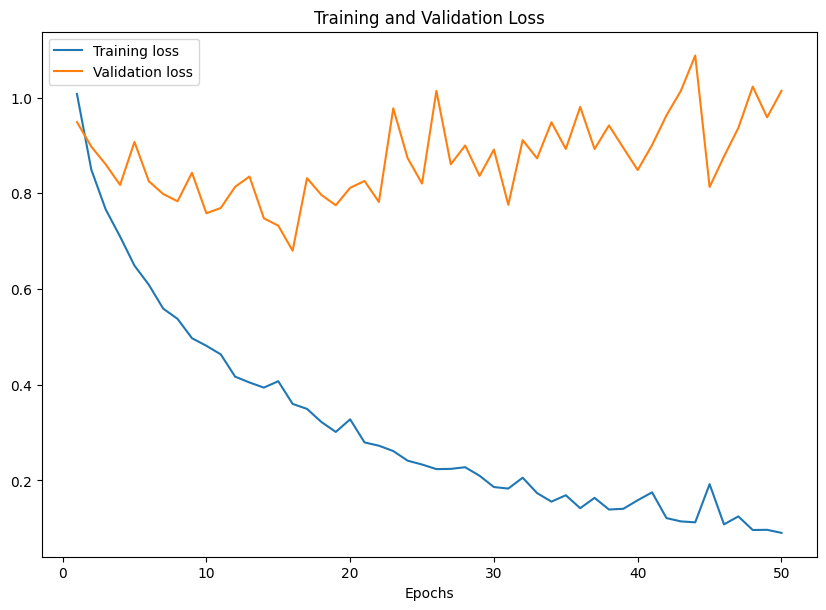

<Figure size 640x480 with 0 Axes>

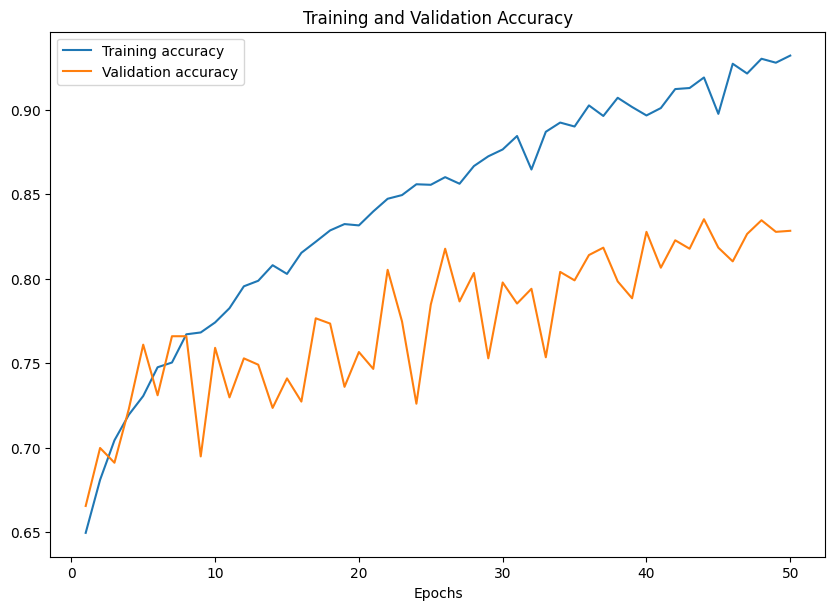

<Figure size 640x480 with 0 Axes>

In [33]:
# plt.plot(losses)
# plt.show()

import matplotlib.pyplot as plt

epoch = range(1, num_epochs+1) # Creating a range of epochs from 1 to num_epochs+1
fig = plt.figure(figsize=(10, 15)) # Creating a new figure for the plots with a specified size
plt.subplot(2,1,2) # Creating a subplot with 2 rows, 1 column, and selecting the second subplot
plt.plot(epoch, losses, label='Training loss') # Plotting the training loss with the epoch on the x-axis
plt.plot(epoch, val_losses, label='Validation loss') # Plotting the validation loss with the epoch on the x-axis
plt.title('Training and Validation Loss') # Setting the title of the plot
plt.xlabel('Epochs') # Setting the label for the x-axis
plt.legend() # Adding a legend to the plot
plt.figure() # Creating a new figure
plt.show() # Displaying the plot

fig = plt.figure(figsize=(10, 15)) # Creating a new figure for the plots with a specified size
plt.subplot(2,1,2) # Creating a subplot with 2 rows, 1 column, and selecting the second subplot
plt.plot(epoch, accuracy, label='Training accuracy') # Plotting the training accuracy with the epoch on the x-axis
plt.plot(epoch, val_accuracy, label='Validation accuracy') # Plotting the validation accuracy with the epoch on the x-axis
plt.title('Training and Validation Accuracy') # Setting the title of the plot
plt.xlabel('Epochs') # Setting the label for the x-axis
plt.legend() # Adding a legend to the plot
plt.figure() # Creating a new figure
plt.show() # Displaying the plot

## Test the network on the test data

We have trained the network over the training dataset.
But we need to check if the network has learnt anything at all.

We will check this by predicting the class label that the neural network
outputs, and checking it against the ground-truth. If the prediction is
correct, we add the sample to the list of correct predictions.

Okay, first step. Let us display an image from the test set to get familiar.



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


GroundTruth:  melanocytic nevi,  melanocytic nevi,  benign keratosis-like lesions,  benign keratosis-like lesions,  vascular lesions,  melanocytic nevi,  melanoma,  melanocytic nevi,  melanocytic nevi,  melanocytic nevi, 


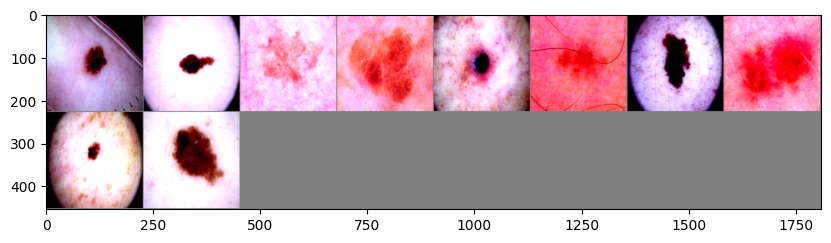

In [36]:
fig = plt.figure(figsize=(10, 15)) # Creating a new figure for the plots with a specified size

dataiter = iter(test_data_loader) # Creating an iterator for the test data loader
images, labels = next(dataiter) # Getting the next batch of images and labels from the test data loader

# print images
imshow(torchvision.utils.make_grid(images)) # Displaying the images in a grid using the imshow function
print('GroundTruth: ', ' '.join('%5s, ' % classes[labels[j]] for j in range(len(labels)))) # Printing the ground truth labels for the displayed images

Okay, now let us check the performance on the test network:



In [37]:
correct = 0 # Initializing the total number of correct predictions to 0
total = 0 # Initializing the total number of samples to 0
net.eval() # Setting the network to evaluation mode
with torch.no_grad(): # Disabling gradient calculation for the following block of code
    for data in test_data_loader: # Iterating over the test data loader
        images, labels = data # Getting the images and labels from the data
        images, labels = images.to(device), labels.to(device) # Moving the images and labels to the specified device
        outputs = net(images) # Passing the images through the network to get the outputs
        _, predicted = torch.max(outputs.data, 1) # Getting the predicted class labels from the outputs
        total += labels.size(0) # Adding the batch size to the total number of samples
        correct += (predicted == labels).sum().item() # Counting the number of correct predictions and adding it to the total number of correct predictions

print('Accuracy of the network on the test images: %d %%' % (100 * correct / total)) # Printing the accuracy of the network on the test images as a percentage

Accuracy of the network on the test images: 83 %


In [38]:
class_correct = list(0. for i in range(len(classes))) # Creating a list of zeros with the length of the classes for storing the number of correct predictions for each class
class_total = list(1e-7 for i in range(len(classes))) # Creating a list of small non-zero values with the length of the classes for storing the total number of samples for each class

with torch.no_grad(): # Disabling gradient calculation for the following block of code
    for data in test_data_loader: # Iterating over the test data loader
        images, labels = data # Getting the images and labels from the data
        images, labels = images.to(device), labels.to(device) # Moving the images and labels to the specified device
        outputs = net(images) # Passing the images through the network to get the outputs
        _, predicted = torch.max(outputs, 1) # Getting the predicted class labels from the outputs
        c = (predicted == labels).squeeze() # Creating a boolean mask of correct predictions
        for i in range(3): # Iterating over the first 3 samples in the batch
            label = labels[i] # Getting the label of the sample
            class_correct[label] += c[i].item() # Incrementing the count of correct predictions for the corresponding class
            class_total[label] += 1 # Incrementing the total count for the corresponding class

for i in range(len(classes)): # Iterating over the classes
    print('Accuracy of %5s : %2d %%' % ( # Printing the accuracy for each class
        classes[i], 100 * class_correct[i] / class_total[i])) # Calculating and printing the accuracy as a percentage for each class

Accuracy of actinic keratoses : 81 %
Accuracy of basal cell carcinoma : 61 %
Accuracy of benign keratosis-like lesions : 73 %
Accuracy of dermatofibroma : 33 %
Accuracy of melanoma : 50 %
Accuracy of melanocytic nevi : 92 %
Accuracy of vascular lesions : 99 %


In [39]:
class_correct = list(0. for i in range(len(classes))) # Creating a list of zeros with the length of the classes for storing the number of correct predictions for each class
class_total = list(1e-7 for i in range(len(classes))) # Creating a list of small non-zero values with the length of the classes for storing the total number of samples for each class
net.eval() # Setting the network to evaluation mode
with torch.no_grad(): # Disabling gradient calculation for the following block of code
    for data in validation_data_loader: # Iterating over the validation data loader
        images, labels = data # Getting the images and labels from the data
        images, labels = images.to(device), labels.to(device) # Moving the images and labels to the specified device
        outputs = net(images) # Passing the images through the network to get the outputs
        _, predicted = torch.max(outputs, 1) # Getting the predicted class labels from the outputs
        c = (predicted == labels).squeeze() # Creating a boolean mask of correct predictions
        for i in range(3): # Iterating over the first 3 samples in the batch
            label = labels[i] # Getting the label of the sample
            class_correct[label] += c[i].item() # Incrementing the count of correct predictions for the corresponding class
            class_total[label] += 1 # Incrementing the total count for the corresponding class

for i in range(len(classes)): # Iterating over the classes
    print('Accuracy of %5s : %2d %%' % ( # Printing the accuracy for each class
        classes[i], 100 * class_correct[i] / class_total[i])) # Calculating and printing the accuracy as a percentage for each class

Accuracy of actinic keratoses : 61 %
Accuracy of basal cell carcinoma : 72 %
Accuracy of benign keratosis-like lesions : 72 %
Accuracy of dermatofibroma : 54 %
Accuracy of melanoma : 55 %
Accuracy of melanocytic nevi : 91 %
Accuracy of vascular lesions : 99 %


### Confusion Matrix

In [40]:
confusion_matrix = torch.zeros(len(classes), len(classes)) # Creating a square matrix of zeros to store the confusion matrix
with torch.no_grad(): # Disabling gradient calculation for the following block of code
    for data in test_data_loader: # Iterating over the test data loader
        images, labels = data # Getting the images and labels from the data
        images, labels = images.to(device), labels.to(device) # Moving the images and labels to the specified device
        outputs = net(images) # Passing the images through the network to get the outputs
        _, predicted = torch.max(outputs, 1) # Getting the predicted class labels from the outputs
        for t, p in zip(labels.view(-1), predicted.view(-1)): # Iterating over the true and predicted labels flattened
            confusion_matrix[t.long(), p.long()] += 1 # Updating the confusion matrix by incrementing the count of true positive predictions

print(confusion_matrix) # Printing the confusion matrix
cm = confusion_matrix.numpy() # Converting the confusion matrix to a numpy array

tensor([[5.7000e+01, 1.0000e+00, 5.0000e+00, 0.0000e+00, 0.0000e+00, 2.0000e+00,
         0.0000e+00],
        [1.5000e+01, 7.0000e+01, 8.0000e+00, 1.0000e+00, 3.0000e+00, 6.0000e+00,
         0.0000e+00],
        [2.0000e+01, 3.0000e+00, 1.5700e+02, 0.0000e+00, 1.1000e+01, 2.9000e+01,
         0.0000e+00],
        [3.0000e+00, 3.0000e+00, 1.0000e+00, 1.1000e+01, 2.0000e+00, 3.0000e+00,
         0.0000e+00],
        [1.3000e+01, 4.0000e+00, 2.0000e+01, 1.0000e+00, 1.2200e+02, 6.3000e+01,
         0.0000e+00],
        [8.0000e+00, 1.2000e+01, 4.5000e+01, 5.0000e+00, 4.2000e+01, 1.2250e+03,
         4.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00,
         2.7000e+01]])


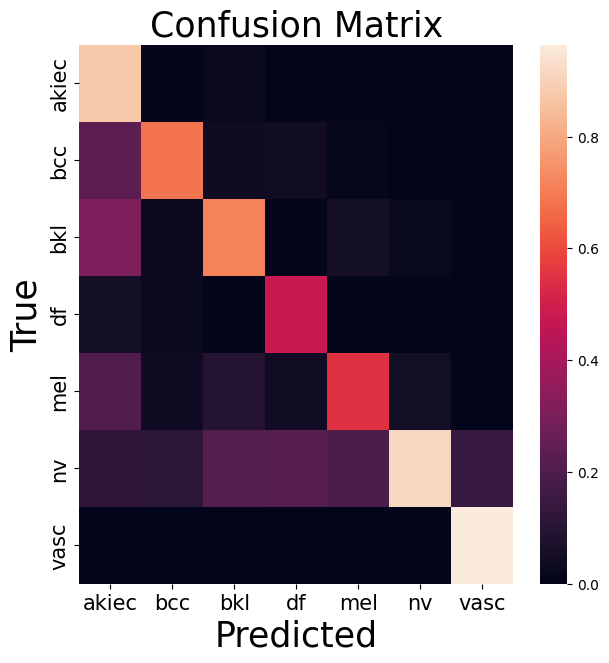

In [41]:
fig, ax = plt.subplots(figsize=(7,7)) # Creating a new figure and axis with a specified size
sns.heatmap(cm / (cm.astype(float).sum(axis=1) + 1e-9), annot=False, ax=ax) # Plotting a heatmap of the normalized confusion matrix with Seaborn, without annotations, on the specified axis

# labels, title and ticks
ax.set_xlabel('Predicted', size=25); # Setting the label for the x-axis
ax.set_ylabel('True', size=25); # Setting the label for the y-axis
ax.set_title('Confusion Matrix', size=25); # Setting the title for the plot
ax.xaxis.set_ticklabels(['akiec','bcc','bkl','df', 'mel', 'nv','vasc'], size=15); # Setting the tick labels for the x-axis
ax.yaxis.set_ticklabels(['akiec','bcc','bkl','df','mel','nv','vasc'], size=15); # Setting the tick labels for the y-axis

### Grad cam

In [44]:
from collections import OrderedDict
from collections.abc import Sequence
# Define a base wrapper class for model interpretation techniques
class _BaseWrapper(object):
    """
    Please modify forward() and backward() according to your task.
    """

# Constructor
    def __init__(self, model):
        super(_BaseWrapper, self).__init__()  # Calling superclass constructor
        # Get the device of the model
        self.device = next(model.parameters()).device  # Obtaining the device of the model
        # Set the model
        self.model = model  # Storing the model
        # Initialize a list to store hook function handlers
        self.handlers = []  # Creating an empty list to store hook function handlers

    # Method to encode labels as one-hot vectors
    def _encode_one_hot(self, ids):
        one_hot = torch.zeros_like(self.logits).to(self.device)  # Creating a tensor of zeros with same shape as logits tensor
        one_hot.scatter_(1, ids, 1.0)  # Modifying the tensor to set specified indices to 1.0
        return one_hot  # Returning the one-hot encoded tensor

    # Method for model forward pass
    def forward(self, image):
        """
        Simple classification
        """
        self.model.zero_grad()  # Resetting gradients
        self.logits = self.model(image)  # Forward pass through the model to obtain logits
        self.probs = F.softmax(self.logits, dim=1)  # Applying softmax activation to obtain probabilities
        return self.probs.sort(dim=1, descending=True)  # Sorting probabilities in descending order

    # Method for class-specific backward pass
    def backward(self, ids):
        """
        Class-specific backpropagation
        Either way works:
        1. self.logits.backward(gradient=one_hot, retain_graph=True)
        2. (self.logits * one_hot).sum().backward(retain_graph=True)
        """


        one_hot = self._encode_one_hot(ids)  # Encoding labels as one-hot vectors
        self.logits.backward(gradient=one_hot, retain_graph=True)  # Backpropagating gradients

    # Method to generate interpretations
    def generate(self):
        raise NotImplementedError  # Indicating that this method must be implemented in subclasses

    # Method to remove all the forward/backward hook functions
    def remove_hook(self):
        """
        Remove all the forward/backward hook functions
        """
        for handle in self.handlers:  # Iterating through hook function handlers
            handle.remove()  # Removing each hook function handler


# Define GradCAM class which inherits from _BaseWrapper
class GradCAM(_BaseWrapper):
    """
    "Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization"
    https://arxiv.org/pdf/1610.02391.pdf
    Look at Figure 2 on page 4
    """

    # Constructor
    def __init__(self, model, candidate_layers=None):
        super(GradCAM, self).__init__(model)  # Calling superclass constructor
        # Initialize OrderedDicts to store feature maps and gradients
        self.fmap_pool = OrderedDict()  # Creating an empty ordered dictionary to store feature maps
        self.grad_pool = OrderedDict()  # Creating an empty ordered dictionary to store gradients
        self.candidate_layers = candidate_layers  # Storing candidate layers for analysis


        # Define forward hook function
        def forward_hook(key):
            def forward_hook_(module, input, output):
                # Save featuremaps
                self.fmap_pool[key] = output.detach()  # Storing feature maps in the feature map pool

            return forward_hook_

        # Define backward hook function
        def backward_hook(key):
            def backward_hook_(module, grad_in, grad_out):
                # Save the gradients correspond to the featuremaps
                self.grad_pool[key] = grad_out[0].detach()  # Storing gradients in the gradient pool

            return backward_hook_


        # If any candidates are not specified, the hook is registered to all the layers.
        for name, module in self.model.named_modules():  # Iterating through model's named modules
            if self.candidate_layers is None or name in self.candidate_layers:  # Checking if the module is a candidate layer
                self.handlers.append(module.register_forward_hook(forward_hook(name)))  # Registering forward hook
                self.handlers.append(module.register_backward_hook(backward_hook(name)))  # Registering backward hook

    # Method to find feature maps or gradients for a given target layer
    def _find(self, pool, target_layer):
        if target_layer in pool.keys():  # Checking if target layer exists in the pool
            return pool[target_layer]  # Returning feature maps or gradients for the target layer
        else:
            raise ValueError("Invalid layer name: {}".format(target_layer))  # Error if target layer does not exist
    
    # Method to compute gradient weights
    def _compute_grad_weights(self, grads):
        return F.adaptive_avg_pool2d(grads, 1)  # Computing average-pooled gradients

    # Method for forward pass with preprocessing
    def forward(self, image):
        self.image_shape = image.shape[2:]  # Storing image shape for interpolation
        return super(GradCAM, self).forward(image)  # Performing forward pass using superclass method

    # Method to generate GradCAM visualizations for a given target layer
    def generate(self, target_layer):
        fmaps = self._find(self.fmap_pool, target_layer)  # Getting feature maps for target layer
        grads = self._find(self.grad_pool, target_layer)  # Getting gradients for target layer
        weights = self._compute_grad_weights(grads)  # Computing gradient weights

        gcam = torch.mul(fmaps, weights).sum(dim=1, keepdim=True)  # Computing GradCAM map
        gcam = F.relu(gcam)  # Applying ReLU activation

        gcam = F.interpolate(
            gcam, self.image_shape, mode="bilinear", align_corners=False
        )  # Interpolating GradCAM map to original image size

        B, C, H, W = gcam.shape  # Getting GradCAM map dimensions
        gcam = gcam.view(B, -1)  # Flattening GradCAM map
        gcam -= gcam.min(dim=1, keepdim=True)[0]  # Normalizing GradCAM map
        gcam /= gcam.max(dim=1, keepdim=True)[0]  # Normalizing GradCAM map
        gcam = gcam.view(B, C, H, W)

        return gcam

/usr/cs/grad/master/ngandu/myenv/lib/python3.12/site-packages/torch/nn/modules/module.py:1352: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


Generating Grad-CAM @layer4
	#0: melanocytic nevi (1.00000)


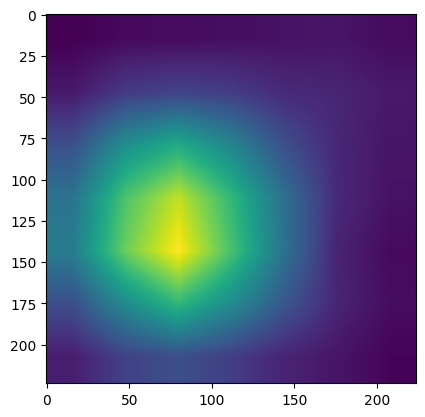

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


True Class:  melanocytic nevi


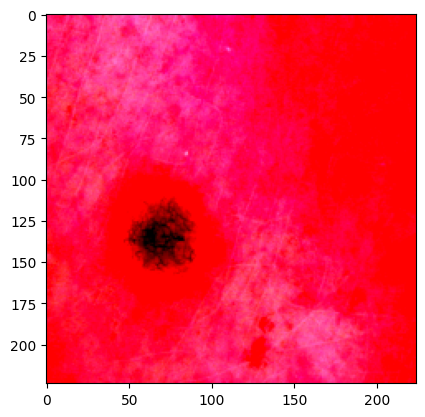

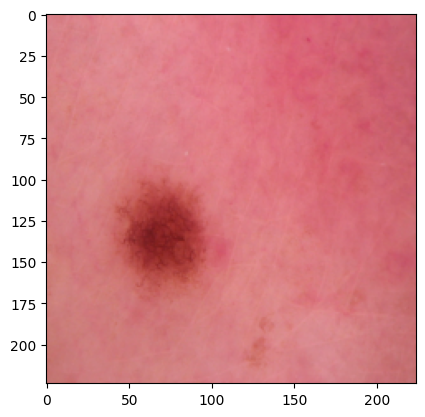

In [45]:
def demo2(image, label, model):
    """
    Generate Grad-CAM
    """
    # Model
    model = model  # Assigning the model to a local variable
    model.to(device)  # Moving the model to the specified device (GPU or CPU)
    model.eval()  # Setting the model to evaluation mode (disabling dropout and batch normalization)

    # The layers
    target_layers = ["layer4"]  # Specifying the target layers for Grad-CAM visualization
    target_class = label  # Storing the target class label

    # Images
    images = image.unsqueeze(0)  # Adding an extra dimension to the image tensor
    gcam = GradCAM(model=model)  # Creating an instance of the GradCAM class with the model
    probs, ids = gcam.forward(images)  # Getting probabilities and predicted class IDs
    ids_ = torch.LongTensor([[target_class]] * len(images)).to(device)  # Creating a tensor of target class IDs
    gcam.backward(ids=ids_)  # Performing backward pass to compute gradients for target class

    for target_layer in target_layers:  # Iterating over target layers for visualization
        print("Generating Grad-CAM @{}".format(target_layer))  # Printing target layer for Grad-CAM

        # Grad-CAM
        regions = gcam.generate(target_layer=target_layer)  # Generating Grad-CAM visualizations for the target layer
        for j in range(len(images)):  # Iterating over images
            print(
                "\t#{}: {} ({:.5f})".format(
                    j, classes[target_class], float(probs[ids == target_class])
                )
            )  # Printing predicted class and probability for each image
            
            gcam = regions[j, 0]  # Extracting Grad-CAM for the current image
            plt.imshow(gcam.cpu())  # Displaying Grad-CAM
            plt.show()  # Showing the plot
            
image, label = next(iter(test_data_loader))  # Getting the next batch of images and labels from the test data loader
# Load the model
model = net  # Assigning the neural network model to a variable
# Grad cam
demo2(image[0].to(device), label[0].to(device), model)  # Generating Grad-CAM visualization for a sample image

# Processing image for visualization
image = np.transpose(image[0], (1,2,0))  # Transposing image dimensions for visualization
image2 = np.add(np.multiply(image.numpy(), np.array(norm_std)), np.array(norm_mean))  # Denormalizing the image
print("True Class: ", classes[label[0].cpu()])  # Printing true class label
plt.imshow(image)  # Displaying the original image
plt.show()  # Showing the plot
plt.imshow(image2)  # Displaying the denormalized image
plt.show()  # Showing the plot


# Conclusion

Training a neural network can be a daunting task, especially for a beginner. Here, are some useful practices to get the best out of your network.

- Training Ensembles — Combine learning from multiple networks.
- Always go for a lower learning rate.
- In cases of limited data try better augmentation techniques[20].
- Network architectures that have the appropriate depth for our problem — too many hyperparameters could lead to suboptimal results if we don’t have enough images.
- Improving loss function and class balancing.

In this tutorial we learned how to train a deep neural network for the challenging task of skin-lesion classification. We experimented with two network architectures and provided insights in the attention of the models. Additionally, we achieved 83% overall accuracy on HAM10000 and provided you with more tips and tricks to tackle overfitting and class imbalance.

Now you have all the tools to not only beat our performance and participate in the exciting MICCAI Challenges, but to also solve many more medical imaging problems.

Happy training!

 